In [4]:
import numpy as np
from scipy.spatial import distance
import copy
import matplotlib.pyplot as plt
from IPython import display

In [5]:
import tensorflow as tf

2023-12-14 14:22:04.370167: E tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:9342] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2023-12-14 14:22:04.370200: E tensorflow/compiler/xla/stream_executor/cuda/cuda_fft.cc:609] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2023-12-14 14:22:04.370205: E tensorflow/compiler/xla/stream_executor/cuda/cuda_blas.cc:1518] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2023-12-14 14:22:04.435804: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: SSE4.1 SSE4.2 AVX AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.


### Description of several Classes for Transformation matrices

In [6]:
import math
import pandas as pd
from numpy import linalg
import warnings

# KUKA  = XYZ ABC
# FANUC = XYZ WPR

# around axis   X      Y      Z
#              ROLL  PITCH   YAW
# KUKA          C      B      A
# FANUC         W      P      R


# KUKA Rotation_matrix = Rz(A) * R'y(B) * R''x(C)
# FANUC Rotation_matrix = (Rx(-W) * Ry(-P) * Rz(-R)).T


class Quaternion:
    def __init__(self,parent_type, w = 0, x = 0, y = 0, z = 0):
        self.w = w
        self.x = x
        self.y = y
        self.z = z
        self.parent_type = parent_type
        
    def __repr__(self):
        return str(type(self)) + "\n" + 'parent_type: ' + str(self.parent_type) + "\n" +  "{ w: " + str(self.w) +"  x: " + str(self.x) + " y: " + str(self.y) + " z: " + str(self.z) + "}"   
        


#################################################################################################
#################################################################################################
class Rotation_matrix:
    def __init__(self, mtx, parent_type):       
        
        self.mtx = mtx
        self.parent_type = parent_type            
    
    def extract_frame(self):
        if self.parent_type == 'KUKA':
            yaw, pitch, roll = angles_from_rot_mtx(self.mtx) 
            frame = KUKA_frame(self.mtx[0,3], self.mtx[1,3], self.mtx[2,3], yaw, pitch, roll)
        
        elif self.parent_type == 'FANUC':
            roll, pitch, yaw = angles_from_rot_mtx(self.mtx)            
            frame = FANUC_frame(self.mtx[0,3], self.mtx[1,3], self.mtx[2,3], yaw, pitch, roll)
            
        else:
            raise Exception('Can not extract frame from matrix. Unknown type of frame')            
            
        return frame    
            
        
    def inv(self):
        inv_mtx_obj = Rotation_matrix(np.linalg.inv(self.mtx), parent_type = self.parent_type)
        
        return inv_mtx_obj
            
            
    def description(self):
        print('-------------------------')
        print(self.mtx)
        print('parent_type: ', self.parent_type)
        print('-------------------------')
    
    def __repr__(self):
        return str(type(self)) + "\n" + 'parent_type: ' + str(self.parent_type) + "\n" +  str(self.mtx)
    
    def __mul__(self, another):
        if self.parent_type != another.parent_type:
            print('Warning! Different parent types of matrices. "{}" type has been assigned to result matrix'.format(self.parent_type))

            
        new_mtx = np.dot(self.mtx, another.mtx)
        # print('new_mtx: ', new_mtx)
        return Rotation_matrix(new_mtx, parent_type = self.parent_type)
        
         
#################################################################################################
#################################################################################################
class KUKA_frame: # XYZ ABC
    def __init__(self, x = 0, y = 0, z = 0, a = 0, b = 0, c = 0):
        self.x = x
        self.y = y
        self.z = z
        self.a = a # Rz
        self.b = b # Ry
        self.c = c # Rx
    
    def __str__(self):
        string = '(X = ' + str(self.x) + ', Y = ' + str(self.y) + ', Z = ' + str(self.z) + ', A = ' + str(self.a) + ', B = ' + str(self.b) + ', C = ' + str(self.c) + ')'
        return string
    
    def __repr__(self):
        return str(type(self)) + "\n" +  str({"x":self.x, "y":self.y, "z":self.z, "a":self.a, "b":self.b, "c":self.c})
    
    def __mul__(self, another):
#         if type(another) != KUKA_frame:
#             raise Exception('different types of frames')
        
#         else:
        return (self.rot_mtx() * another.rot_mtx()).extract_frame()
            
        
    def inv(self):
        return self.rot_mtx().inv().extract_frame()
 
    
    def to_tuple(self):
        return (round(self.x,6), round(self.y, 6), round(self.z, 6), round(self.a, 6), round(self.b, 6), round(self.c, 6))
    
    
    def rot_mtx(self):
        
        mtx = transform_mtx_from_frame(self)
        return Rotation_matrix(mtx = mtx, parent_type = 'KUKA' )
    
    def round_elements(self, num : int):
        return KUKA_frame(
            round(self.x, num),
            round(self.y, num),
            round(self.z, num),
            round(self.a, num),
            round(self.b, num),
            round(self.c, num)
            )
            
#################################################################################################
#################################################################################################    
class FANUC_frame: # XYZ WPR
    def __init__(self, x = 0, y = 0, z = 0, w = 0, p = 0, r = 0):
        self.x = x
        self.y = y
        self.z = z
        self.w = w 
        self.p = p
        self.r = r
    
    def __str__(self):
        string = '(X = ' + str(self.x) + ', Y = ' + str(self.y) + ', Z = ' + str(self.z) + ', W = ' + str(self.w) + ', P = ' + str(self.p) + ', R = ' + str(self.r) + ')'
        return string
    
    def __repr__(self):
        return str(type(self)) + "\n" +  str({"x":self.x, "y":self.y, "z":self.z, "w":self.w, "p":self.p, "r":self.r})
    
    def __mul__(self, another):
#         if type(another) != FANUC_frame:
#             raise Exception('different types of frames')
        
#         else:
        return (self.rot_mtx() * another.rot_mtx()).extract_frame()
        
        
    def inv(self):
        return self.rot_mtx().inv().extract_frame()        
        
        
    def to_tuple(self):
        return (round(self.x,6), round(self.y, 6), round(self.z, 6), round(self.w, 6), round(self.p, 6), round(self.r, 6))    
    
    def rot_mtx(self):
        mtx = transform_mtx_from_frame_extrinsic(self)
        return Rotation_matrix(mtx = mtx, parent_type = 'FANUC' )

    
    
    
#################################################################################################
#################################################################################################    
def angles_from_rot_mtx(rot_mtx):
    A = np.arctan2(rot_mtx[1,0], rot_mtx[0,0])
    sin_A = math.sin(A)
    cos_A = math.cos(A)
    
    sin_B = -1 * rot_mtx[2,0]
    abs_cos_B = cos_A * rot_mtx[0,0] + sin_A * rot_mtx[1,0]
    B = np.arctan2(sin_B, abs_cos_B)
    
    sin_C = sin_A * rot_mtx[0,2] - cos_A * rot_mtx[1,2]
    cos_C = - 1 * sin_A * rot_mtx[0,1] + cos_A * rot_mtx[1,1]
    C = np.arctan2(sin_C, cos_C)
    
    return np.degrees(A), np.degrees(B), np.degrees(C)

def extract_frame(transform_matrix):
    a, b, c = angles_from_rot_mtx(transform_matrix)
   
    frame = KUKA_frame(transform_matrix[0,3], transform_matrix[1,3], transform_matrix[2,3], a, b, c)
      
    return frame


def rot_mtx_around_Z(a): # A - angle around Z axis in degrees 
    Angle_around_Z = math.radians(a)  # Angle A
    
    matrix_turn_around_Z = np.array([
        [math.cos(Angle_around_Z), -1 * math.sin(Angle_around_Z), 0, 0],
        [math.sin(Angle_around_Z), math.cos(Angle_around_Z), 0, 0],
        [0, 0, 1, 0],
        [0, 0, 0, 1]
    ])
    
    return matrix_turn_around_Z

def rot_mtx_around_Y(b): # B - angle around Y axis in degrees 
    Angle_around_Y = math.radians(b)  # Angle B
    
    matrix_turn_around_Y = np.array([
        [math.cos(Angle_around_Y), 0, math.sin(Angle_around_Y), 0],
        [0, 1, 0, 0],
        [-1 * math.sin(Angle_around_Y), 0,  math.cos(Angle_around_Y), 0],
        [0, 0, 0, 1]
    ])

    return matrix_turn_around_Y

def rot_mtx_around_X(c): # C - angle around Y axis in degrees 
    Angle_around_X = math.radians(c)  # Angle C

    matrix_turn_around_X = np.array([
        [1, 0, 0, 0],
        [0, math.cos(Angle_around_X), -1 * math.sin(Angle_around_X), 0],
        [0, math.sin(Angle_around_X), math.cos(Angle_around_X), 0],
        [0, 0, 0, 1]
    ])
    
    return matrix_turn_around_X

def rot_mtx_vector(x, y, z):
    mtx = np.eye(4)
    mtx[0,3] = x
    mtx[1,3] = y
    mtx[2,3] = z
    mtx[3,3] = 1
    return mtx
    
# INTRINSIC mtx = Rz * R'y * R''x
def transform_mtx_from_frame(frame): 
    matrix_turn_around_Z = rot_mtx_around_Z(frame.a)
    matrix_turn_around_Y = rot_mtx_around_Y(frame.b)
    matrix_turn_around_X = rot_mtx_around_X(frame.c) 
    vector_mtx = rot_mtx_vector(frame.x, frame.y, frame.z)
    
    evolution_matrix = np.dot( np.dot( np.dot( vector_mtx, matrix_turn_around_Z), matrix_turn_around_Y), matrix_turn_around_X)
    
    return evolution_matrix

 
def inv_pos(frame): #FRAME as input    
    evolution_matrix = transform_mtx_from_frame(frame) #turn matrix
        
    #make inverse matrix
    inv_matrix = np.linalg.inv(evolution_matrix)
    
    #Turt matrix to frame
    
    inv_frame = extract_frame(inv_matrix)
    #print(inv_frame)
    
    return inv_frame


# Reorient tool in reference to TOOL frame axis
def rotateInToolCoord(source_point, shift_frame_Angles): # x,y,z must be zero
    #RESULT = source_point : shift_frame_Angles (and stay the initial point unchanged)
    
    shift_frame_Angles.x=0
    shift_frame_Angles.y=0
    shift_frame_Angles.z=0
    result_frame = extract_frame( np.dot(transform_mtx_from_frame(source_point), transform_mtx_from_frame(shift_frame_Angles)))
    return result_frame


# Reorient tool in reference to BASE frame axis
def rotateInBaseCoord(source_point : KUKA_frame, shift_frame_Angles : KUKA_frame) -> KUKA_frame:     # x,y,z must be zero
    #RESULT = shift_frame_Angles : source_point (and stay the initial point unchanged)
    
    shift_frame_Angles.x=0
    shift_frame_Angles.y=0
    shift_frame_Angles.z=0


    tempFrame = copy.copy(source_point)
    tempFrame.x = 0
    tempFrame.y = 0
    tempFrame.z = 0
    
    # print('TempFrame', TempFrame)
    
    tempFrame = extract_frame(np.dot(transform_mtx_from_frame(shift_frame_Angles), transform_mtx_from_frame(tempFrame) ))
    # print('TempFrame', TempFrame)
    
    result_frame =  source_point
    
    # print('Result_frame', Result_frame)
    
    result_frame.a =  tempFrame.a
    result_frame.b =  tempFrame.b
    result_frame.c =  tempFrame.c
    
    return result_frame

def from_base_to_base(source_point : KUKA_frame, source_base : KUKA_frame, target_base : KUKA_frame) -> KUKA_frame:
    # Source point doesn't move. Just recalculated in reference to Target_base
        
    temp_mtx = np.dot(transform_mtx_from_frame(source_base), transform_mtx_from_frame(source_point))
    temp_mtx = np.dot(transform_mtx_from_frame(inv_pos(target_base)), temp_mtx)

    result_frame = extract_frame(temp_mtx)
    
    return result_frame

# EXTRINSIC for FANUC  XYZ WPR.   angles(W = Rx, P = Ry, R = Rz)
def transform_mtx_from_frame_extrinsic(frame): 
    matrix_turn_around_Z = rot_mtx_around_Z(-frame.r)
    matrix_turn_around_Y = rot_mtx_around_Y(-frame.p)
    matrix_turn_around_X = rot_mtx_around_X(-frame.w) 
    vector_mtx = rot_mtx_vector(frame.x, frame.y, frame.z)
    
    
    evolution_matrix = np.dot(vector_mtx, np.dot( np.dot(matrix_turn_around_X, matrix_turn_around_Y), matrix_turn_around_Z).T)
    return evolution_matrix


# KUKA  = XYZ ABC
# FANUC = XYZ WPR

# around axis   X      Y      Z
#              ROLL  PITCH   YAW
# KUKA          C      B      A
# FANUC         W      P      R


def angles_to_quaternion(roll,pitch,yaw):     
    yaw = math.radians(yaw)
    pitch = math.radians(pitch)
    roll = math.radians(roll)
    
    q = {'w' : 0,
         'x' : 0,
         'y' : 0,
         'z' : 0
     }
    
    q['w'] = math.cos(yaw/2) * math.cos(pitch/2) * math.cos(roll/2) + math.sin(yaw/2) * math.sin(pitch/2) * math.sin(roll/2)
    q['x'] = math.cos(yaw/2) * math.cos(pitch/2) * math.sin(roll/2) - math.sin(yaw/2) * math.sin(pitch/2) * math.cos(roll/2)
    q['y'] = math.cos(yaw/2) * math.sin(pitch/2) * math.cos(roll/2) + math.sin(yaw/2) * math.cos(pitch/2) * math.sin(roll/2)
    q['z'] = math.sin(yaw/2) * math.cos(pitch/2) * math.cos(roll/2) - math.cos(yaw/2) * math.sin(pitch/2) * math.sin(roll/2)
    
    
    return q


def quaternion_to_angles(quaternion):
    # A yaw around Z
    yaw = math.degrees(np.arctan2(2 * (quaternion['w'] * quaternion['z'] + quaternion['x'] * quaternion['y']) ,
                 1 - 2 * (quaternion['y']**2 + quaternion['z']**2))) #* 180 / np.pi
    # B pitch around Y
    pitch = math.degrees(np.arcsin(2 * (quaternion['w'] * quaternion['y'] - quaternion['z'] * quaternion['x'])))# * 180 / np.pi
#     B = math.degrees(np.arctan2(1+ 2 * (quaternion['w'] * quaternion['y'] - quaternion['x'] * quaternion['z']),
#                                (1 - 2* (quaternion['w'] * quaternion['y'] - quaternion['x'] * quaternion['z']))))# * 180 / np.pi
    
    # C roll around X
    roll = math.degrees(np.arctan2(2 * (quaternion['w'] * quaternion['x'] + quaternion['y'] * quaternion['z']) ,
                 1 - 2 * (quaternion['x']**2 + quaternion['y']**2)))# * 180 / np.pi
    # print('yaw: ', yaw, 'pitch: ', pitch, 'roll: ', roll)
    return roll, pitch, yaw

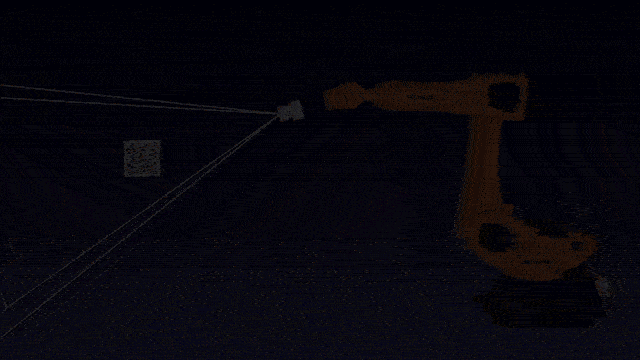

### Get positions of the Robot Flange in respect to Robot base (robot zero point)
### rf_1, rf_2,... rf_n

In [9]:
rob_frames_list =[
    
[1764.02292, 0.0, 1761.52636, -180.0, 84.0, -180.0], 
[1827.95246, -251.30155, 951.77186, -96.015, -84.623, -68.804],        
[1931.05579, -967.23939, 1083.15431, -26.05476, 66.41021, -64.06251],  
[1507.34363, -221.44925, 2067.93555, -164.93109, 66.19657, 180.0],     
[2215.94371, 1052.15147, 1683.43226, 142.69729, 81.55418, -177.44157], 
[2342.28769, 252.65205, 1452.60974, -100.15287, 75.10792, -94.09057],  
[2487.90625, -383.43078, 1708.89868, 105.50976, -13.92187, 114.27994], 
[2395.00814, 209.79634, 1867.01265, 56.18247, -31.0776, 129.40267],    
[1904.86438, -596.74658, 1719.98706, 120.29778, 5.73364, 111.18403],
[2101.76441, -451.72244, 1317.45581, 99.78435, -49.31644, 100.63018],
[2322.09131, -181.78218, 1120.96753, 99.78435, -49.31644, 88.20804],
[1970.31128, 236.77966, 1301.53845, 70.18229, -8.13688, 88.92815],
[1922.16199, 351.10956, 1491.38354, 70.18229, -8.13688, 102.66333],
[1902.10771, -92.65591, 1658.77306, 90.81134, -15.91346, 108.67867],
[1673.39014, -857.09711, 1509.50867, 100.26297, -18.72506, 105.85829],
[2439.25637, -848.14129, 1411.81488, 110.24204, -67.00715, 111.78587],
[1946.1886, 206.64883, 595.28931, 96.03271, -48.1763, 70.45085],
[2117.94053, 644.80012, 1266.82333, 53.45774, -64.46092, 99.69609],
[2306.00586, 402.15448, 1736.193, 57.17004, -41.10065, 108.74191],
[1561.31751, -241.4837, 974.88123, 85.13561, -70.208, 99.94567],

    
]
len(rob_frames_list)

20

### Get positions of the Target in respect to Camera's point of view (camera zero point)
### co_1, co_2, ..., co_n

In [10]:
cam_frames_list =   [

[260.8145, 40.0, 1583.83336, -174.9726, 5.97708, 140.52484],
[301.55862, 170.17237, 1505.43025, -0.18783, -0.6341, 124.79547],
[245.81359, -265.55758, 1629.86266, -154.70023, -6.85195, 99.51031],
[-163.75923, -307.18977, 1923.94537, -174.67141, 25.01122, 127.13442],
[120.47355, 150.27115, 1444.34505, -175.76986, 5.21429, -179.65287],
[141.58369, -33.94799, 985.54406, -160.17329, 0.50723, 146.26686],
[-6.56842, 128.44029, 955.27984, 79.92544, 25.28685, 120.42045],
[189.46834, 127.31308, 1027.83586, 57.83029, 31.85924, 153.93923],
[-292.04129, 242.78241, 1525.66121, 100.95086, 23.3577, 113.7374],
[130.02218, 123.70534, 1274.18751, 45.00365, 8.41639, 122.75684],
[130.02217, 80.91984, 1009.33287, 45.61575, -0.432, 131.50562],
[383.60634, -87.37516, 1304.98771, 86.56588, -2.76317, 159.81237],
[266.41967, 155.7392, 1398.78919, 86.50622, 10.94716, 158.98235],
[5.25112, 208.68968, 1436.87494, 78.49025, 18.39925, 135.52787],
[433.54975, 223.68418, 1784.78239, 75.60856, 16.27638, 125.88042],
[57.58363, 147.30845, 1155.48891, 25.38759, 11.55802, 100.22888],
[294.52966, 121.27377, 1483.05304, 45.22395, -13.60735, 147.6225],
[216.2933, -101.04158, 1289.46305, 29.64466, 1.82366, 168.00934],
[37.09637, -150.15153, 1109.72556, 52.14734, 12.23511, 161.34648],
[461.1419, 40.60691, 1741.67462, 24.51233, 3.73219, 135.80433],

    
]
len(cam_frames_list)

20

### Let's describe the idea of AX = XB (eye-on-hand) camera calibration

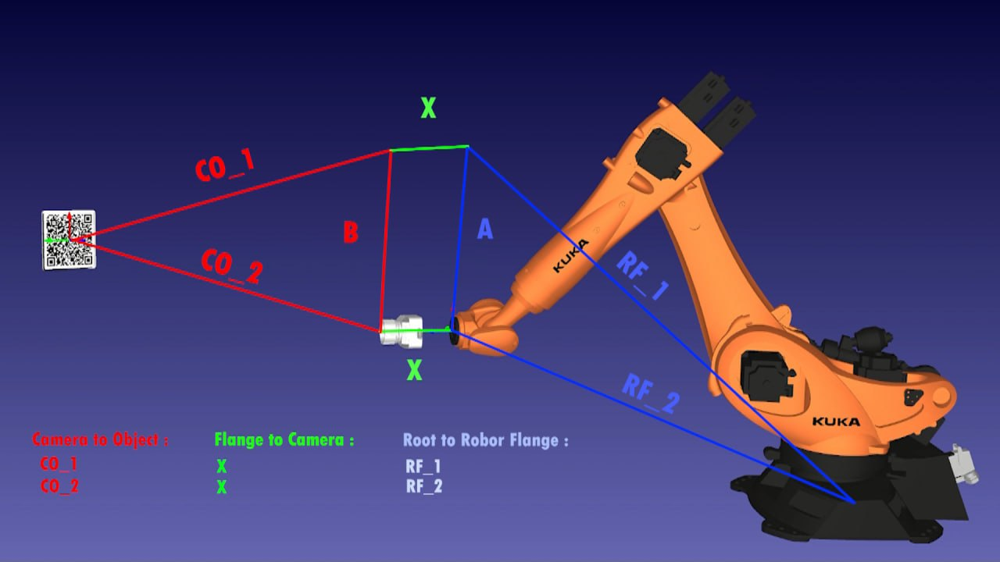

### And here we are getting the equasion in vector form. We can use this equasion for Loss function

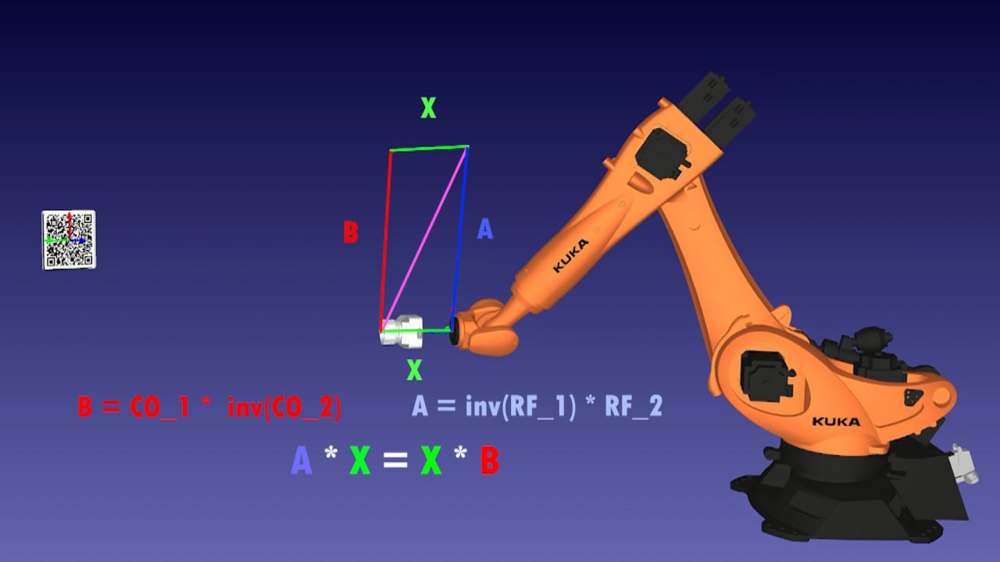

### BUILD VECTORS A , B from rob_frames_list, cam_frames_list

In [12]:
def build_kuka_fr(fr): # builds KUKA_frame from (x, y, z, a, b, c)
    kuka_fr = KUKA_frame(x= fr[0], y = fr[1], z = fr[2], a = fr[3], b = fr[4], c = fr[5])
    return kuka_fr

def build_rot_mtx_vec_A(kuka_fr_1, kuka_fr_2): 
    res_rot_mtx = kuka_fr_1.rot_mtx().inv() * kuka_fr_2.rot_mtx()
    return res_rot_mtx.mtx

def build_rot_mtx_vec_B(cam_fr_1, cam_fr_2): 
    res_rot_mtx = cam_fr_1.rot_mtx() * cam_fr_2.rot_mtx().inv()
    return res_rot_mtx.mtx
        

In [13]:
def make_unique_indexes(num_of_positions):
    indexes_arr = list()
    for i in range(num_of_positions):
        if i < num_of_positions:
            for j in range(i + 1, num_of_positions, 1):  
                indexes_arr.append((i, j))

    return indexes_arr                

### Create np arrays of rotation matrices with shape [n_samples, 4, 4].    n_samples =  number of positions

In [14]:
def build_mass_A_B(rob_frames_list, cam_frames_list):
    if len(rob_frames_list) != len(cam_frames_list):
        return None 

    unique_indexes = make_unique_indexes(len(rob_frames_list)) # build list of unique indexes
    
    data_A = np.empty(shape = (len(unique_indexes), 4, 4)).astype(np.float32)
    data_B = np.empty(shape = (len(unique_indexes), 4, 4)).astype(np.float32)
    # data_A = np.empty(shape = (len(unique_indexes), 3, 3), dtype=float)
    # data_B = np.empty(shape = (len(unique_indexes), 3, 3), dtype=float)

    
    for num, (ind_1, ind_2)  in  enumerate(unique_indexes):
        kuka_fr_1 = build_kuka_fr(rob_frames_list[ind_1])
        kuka_fr_2 = build_kuka_fr(rob_frames_list[ind_2])
        data_A[num] = build_rot_mtx_vec_A(kuka_fr_1, kuka_fr_2) #[:3, :3]  #changed

        cam_fr_1 = build_kuka_fr(cam_frames_list[ind_1])
        cam_fr_2 = build_kuka_fr(cam_frames_list[ind_2])
        data_B[num] = build_rot_mtx_vec_B(cam_fr_1, cam_fr_2) #[:3, :3]  #changed


    return data_A, data_B
        

        
data_A, data_B  =  build_mass_A_B(rob_frames_list, cam_frames_list)

/tmp/ipykernel_5059/4291807489.py:8: RuntimeWarning: overflow encountered in cast
  data_A = np.empty(shape = (len(unique_indexes), 4, 4)).astype(np.float32)
/tmp/ipykernel_5059/4291807489.py:9: RuntimeWarning: overflow encountered in cast
  data_B = np.empty(shape = (len(unique_indexes), 4, 4)).astype(np.float32)


### Create datasets for A and B rotation matrices

In [15]:
BUFFER_SIZE = len(rob_frames_list)
BATCH_SIZE =  20 #20

def create_dataset(np_arr, buffer_size = BUFFER_SIZE, batch_size = BATCH_SIZE):
    train_dataset = tf.data.Dataset.from_tensor_slices(np_arr)
    # train_dataset = train_dataset.shuffle(BUFFER_SIZE).batch(BATCH_SIZE) # DON'T use SHUFFLE - need use the same from A and B
    train_dataset = train_dataset.batch(BATCH_SIZE)
    return train_dataset
    
    
dataset_A = create_dataset(data_A, buffer_size = BUFFER_SIZE, batch_size = BATCH_SIZE)
dataset_B = create_dataset(data_B, buffer_size = BUFFER_SIZE, batch_size = BATCH_SIZE)

2023-12-14 14:22:18.861628: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:894] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-12-14 14:22:18.947660: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:894] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-12-14 14:22:18.951876: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:894] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysf

In [16]:
def add_row(tf_var): 
    """
    Add row of [0, 0, 0, 1] at the bottom of x_mtx varible.
    Make it's shape [4,4] from [3,4]
    This is necessary to make multiplication of rotation matrices
    """
    a = tf.unstack(tf_var)
    row = tf.constant( np.array([0, 0, 0, 1]).astype(np.float32))
    a.append(row)
    tf_var = tf.stack(a)
    return tf_var

def x_mtx_2_kuka_frame(x_mtx ):
    """
    From [4,4] shaped Rotation matrix -> getting KUKA_frame (X, Y, Z, A, B, C))
    """
    temp = np.zeros(shape=(4,4))
    temp[:3, :] = x_mtx.numpy()
    temp[3, :] = [0, 0, 0, 1]
    x_mtx_obj = Rotation_matrix(mtx = temp, parent_type = 'KUKA')
    x_fr = x_mtx_obj.extract_frame()
    return np.array([x_fr.x, x_fr.y, x_fr.z, x_fr.a, x_fr.b, x_fr.c])

def plot_frame_history(x_fr_history ):
    """
    Visualization of evolving X, Y, Z, A, B, C during the all process of optimization
    """
    fig, axs = plt.subplots(3, 2, figsize=(120, 60))
    # for i, alpha in enumerate(np.linspace(0, 1, n)):
    #     curr_vec = v_1 * (1-alpha) + v_2 * alpha
    #     image = generate_data(curr_vec, generator)[0]
        # print(type(image))
    axs[0][0].set_title('X axis')
    axs[0][0].plot(x_fr_history[:, 0])
    
    axs[1][0].set_title('Y axis')
    axs[1][0].plot(x_fr_history[:, 1])
        
    axs[2][0].set_title('Z axis')
    axs[2][0].plot(x_fr_history[:, 2])

        
    axs[0][1].set_title('A angle')
    axs[0][1].plot(x_fr_history[:, 3])

    axs[1][1].set_title('B angle')
    axs[1][1].plot(x_fr_history[:, 4])

    axs[2][1].set_title('BCangle')
    axs[2][1].plot(x_fr_history[:, 5])
    # axs[0].axis('off')

### Description of the Train step and all Training process

In [39]:
var = np.array([
    [0, 0, 0, 0],
    [0, 0, 0, 0],
    [0, 0, 0, 0]
]).astype(np.float32)

# Create the main variable with shape [3, 4]. 
x_mtx = tf.Variable(var)

# Init optimizer
opt = tf.keras.optimizers.legacy.Adam(learning_rate=1, amsgrad = True) # learning_rate=0.5, amsgrad = True

# Init loss function

def loss(A_batch, B_batch, x_mtx):

    tmp_x_mtx = add_row(x_mtx)
    
    ax = tf.linalg.matmul(A_batch, tmp_x_mtx, transpose_b=False)    
    xb = tf.linalg.matmul(tmp_x_mtx, B_batch,  transpose_b=False) 
    
    act_loss = tf.keras.losses.MeanSquaredError()(ax, xb)   
    
    return act_loss

def train_step(x_mtx, loss_func, A_batch, B_batch):
    """
    Optimization step implemented without .fit()

    """
    #################################################
    with tf.GradientTape() as tape: # recording of the gradients from every step of optimization 
        loss = loss_func(A_batch, B_batch, x_mtx)
    
    grad = tape.gradient(loss, x_mtx) # dLoss/dImage
    opt.apply_gradients([(grad, x_mtx)]) # one step of gradient descent: image = image - lambda*dLoss/dImage                                         
    ###################################################
    return loss.numpy()

def train(x_mtx, loss_func, dataset_A, dataset_B, num_epochs = 1000):
    # init the iterators of DATASETs
    loss_history = list()
    x_fr_history = np.array([0,0,0,0,0,0])
    datasetA_iterator = iter(dataset_A)
    datasetB_iterator = iter(dataset_B)

    for epoch in range(num_epochs):
        # create batches of data
        for A_batch,  B_batch in zip(dataset_A, dataset_B):   
            loss_value = train_step(x_mtx, loss_func, A_batch, B_batch)
            
        loss_history.append(loss_value)
        x_fr_history = np.vstack( (x_fr_history, x_mtx_2_kuka_frame(copy.deepcopy(x_mtx)))) # add postprocessed x_mtx to history

        if epoch % 2 == 0:
            display.clear_output(wait=True)
            print('Epoch {}: loss: {}'.format(epoch, loss_value))
            print(x_mtx.numpy())
            plt.plot(loss_history)
            plt.show()

        if loss_value < 0.0001:
            break

    print(x_mtx_2_kuka_frame(x_mtx))
    return x_mtx_2_kuka_frame(x_mtx), loss_history, x_fr_history

### START TRAIN PROCESS 

Epoch 826: loss: 0.00010213073983322829
[[ 9.9997234e-01  8.0716227e-06 -6.9950993e-06 -1.2122465e-03]
 [ 2.2052200e-07  9.9998921e-01 -7.0609244e-06 -5.4019113e-04]
 [-4.7039430e-07  2.5199166e-05  9.9997932e-01  3.5002539e+02]]


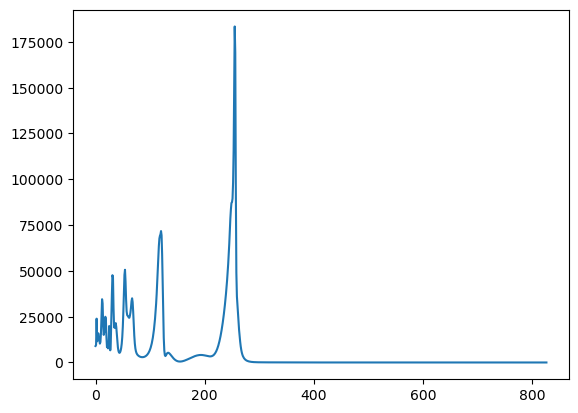

[-1.19479001e-03 -5.31383732e-04  3.50025085e+02  9.39106243e-06
  2.21202394e-05  3.96524625e-04]
CPU times: user 2min, sys: 1min 13s, total: 3min 13s
Wall time: 1min 52s


In [40]:
%%time

# START TRAIN PROCESS 
result_kuka_frame, loss_history, x_fr_history = train(x_mtx, loss, dataset_A, dataset_B, num_epochs= 10000)

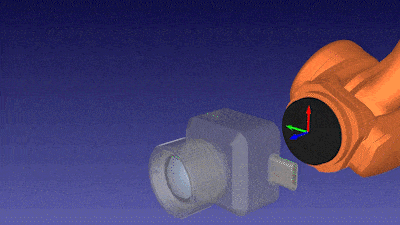

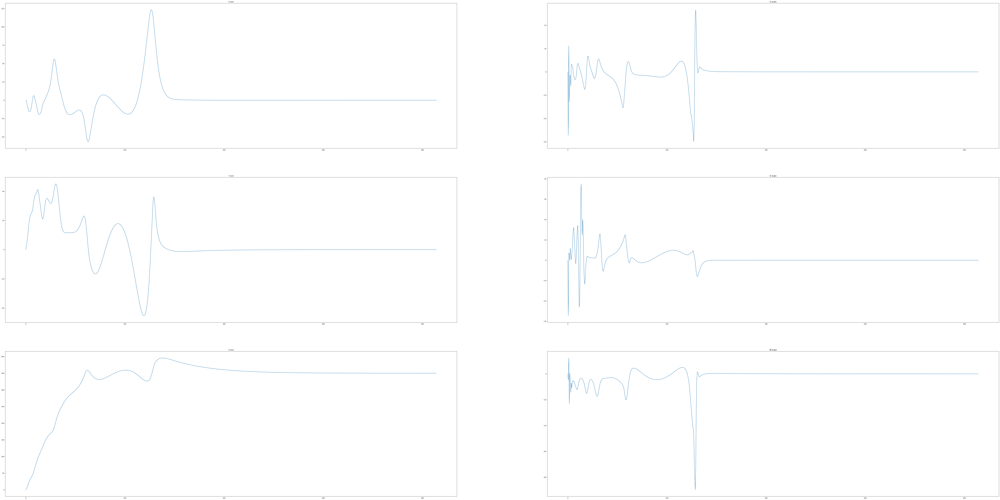

In [22]:
plot_frame_history(x_fr_history)